#### Useful libraries

Find below useful libraries:

* deel-lip for Lipschitz layers (mandatory)
* tqdm for progress bar (mandatory but can be removed without breaking the code)
* wandb for uploading graphs to wandb.ai when you have an account (nice plots and saving to the cloud !) (optional)
* plotly for plotting - available in Colab. In jupyter notebook you need "jupyterlab>=3" and "ipywidgets>=7.6". Installation of Javascript might be required.

In [1]:
# !pip install tqdm
# !pip install wandb
# !pip install deel-lip
# !pip install plotly

In [2]:
import os

try:
    os.environ['WANDB_NOTEBOOK_NAME'] = 'OneClassDraft.ipynb'
    import wandb
    wandb.login()
    wandb_available = True
except ModuleNotFoundError as e:
    print(e)
    print("Wandb logs will be removed.")
    wandb_available = False

wandb: Currently logged in as: algue (use `wandb login --relogin` to force relogin)


The files `lipschitz_normalizers.py` and `utils` are required.

## Define Lipschitz discriminator network

In [3]:
import tensorflow as tf
import deel
from deel.lip.initializers import SpectralInitializer
from deel.lip.layers import SpectralDense, SpectralConv2D, LipschitzLayer, Condensable, InvertibleDownSampling, FrobeniusDense
from deel.lip.activations import MaxMin, GroupSort, GroupSort2, FullSort
from deel.lip.model import Sequential as DeelSequential
from deel.lip.activations import PReLUlip, GroupSort, FullSort
from lipschitz_normalizers import NormalizedDense
from tensorflow.keras.layers import InputLayer


def discriminator(widths, input_shape, k_coef_lip=1., groupsort=False, spectral_dense=False, projection=False):
    """Create Lipschitz network.
    
    Args:
        widths: sequence of widths for the network.
        input_shape: tuple corresponding to the shape of the input.
        k_coef_lip: correcting factor (default: 1.).
        groupsort: whether to use GroupSort (if True) or FullSort( if False). Default to False.
        spectral_dense: whether to use SpectralDense or NormalizedDense (default: False).
            NormalizedDense is an optional parametrization corresponding to the work of Anil et al. (2018).
            It enjoys theoretical guarantees but suffer from vanishing gradient.
        projection: whether to perform condense() after each step or not (default: False). Only available when spectral_dense=True.
        
    Returns:
        A Lipschitz network.
    """
    # multivariate universal approximation holds
    layers = [InputLayer(input_shape)]
    if spectral_dense:
        layers.append(SpectralDense(widths[0]))
    else:
        layers.append(NormalizedDense(widths[0], normalizer='2-inf', projection=projection))
    activation = GroupSort if groupsort else FullSort
    layers.append(activation())
    for width in widths[1:]:
        if spectral_dense:
            layers.append(SpectralDense(width))
        else:
            layers.append(NormalizedDense(width, normalizer='inf', projection=projection))
        layers.append(activation())
    # linear decision without activation
    if spectral_dense:
        layers.append(FrobeniusDense(1))
    else:
        layers.append(NormalizedDense(1, normalizer='inf', projection=projection))
    model = DeelSequential(layers, k_coef_lip=k_coef_lip)
    return model

In [4]:
from tensorflow.keras.layers import Dense
from tensorflow.keras.models import Sequential

def conventional(widths, input_shape):
    """Create conventional network.
    
    Args:
        widths: sequence of widths for the network.
        input_shape: tuple corresponding to the shape of the input.
        
    Returns:
        A conventional network.
    """
    # multivariate universal approximation holds
    layers = [InputLayer(input_shape)]
    activation =  tf.keras.layers.ReLU
    for width in widths:
        layers.append(Dense(width))
        layers.append(activation())
    layers.append(Dense(1))
    model = Sequential(layers)
    return model

### Algorithm

In [5]:
import pandas as pd
import sklearn.preprocessing as preprocessing
import tqdm
import numpy as np

In [6]:
# Transform Numpy dataset into Tf.Dataset.
def build_dataset(x, batch_size):  # create a tf.Dataset from numpy array
    """Build a tf.dataset from np.array of shape (N, F) with some batch_size.
    
    Perform automatic shuffling.
    """
    x = np.random.permutation(x).astype('float32')
    ds = tf.data.Dataset.from_tensor_slices(x)
    to_shuffle = 2
    ds = ds.repeat().shuffle(to_shuffle*batch_size).batch(batch_size).prefetch(4)
    return ds

In [7]:
# Rescale input and change labels.
def default_process(X, y):
    """Pre-processed dataset.
    
    Args:
        X: dataset of shape (N, F) with N the number of samples, F the dimension.
        y: vector of shape (N,) of binary labels.
    
    Returns:
        pre-processed pair (X, y).
    """
    y = 2*y - 1
    scaler = preprocessing.StandardScaler()
    X = scaler.fit_transform(X)
    return X, y

#### Initialize adversarial examples uniformly in the domain.

In [8]:
# l2 norm for vectors.
def compute_norm(vec):
    """Return the l2 norm of a vector."""
    square_norm = tf.reduce_sum(vec ** 2., axis=tuple(range(1, len(vec.shape))), keepdims=True)
    return square_norm ** 0.5

In [9]:
def uniform_sampler(gen, batch_size, input_shape):
    """Return a batch of "seeds" uniformly sampled in ball of radius that depends on enclosing domain.
    
    Args:
        gen: tf.random.Generator for reproducibility and speed. Currently unused.
        batch_size: B.
        input_shape: tuple corresponding to the shape of the input.
    Return:
        tensor of shape (B, F).
    """
    dim = np.prod(input_shape)
    radius_max = ((config.domain[1] - config.domain[0])/2.)
    radius     = tf.random.uniform(shape=(batch_size,) + (1,)*len(input_shape), minval=0., maxval=1.)
    radius     = radius ** (1/dim)
    seeds = tf.random.normal(shape=(batch_size,)+input_shape, mean=0., stddev=1.)
    seeds = seeds / compute_norm(seeds)
    seeds = seeds * radius * radius_max
    return seeds

#### Adapted Newton-Raphson algorithm.
 
Next, we update the proposal distribution by following the gradient of the classifier.

In [10]:
def adversarial_sampler(model, loss_fn, gen, seeds, *, infos=False):
    """Return a batch of adversarial samples - distribution Q_t in paper.
    
    Args:
        model: classifier - function f_t in paper.
        loss_fn: loss object with `margin` attribute to calibrate the seeking of adversaries.
        gen:  tf.random.Generator for reproducibility and speed. Currently unused.
        seeds: tensor of shape (B, F) of initial proposal for adversarial samples. They will be improved by following the gradient of the classifier.
        infos: return useful infos for plot and debuging (Default: False).
        
    Returns:
        tensor of shape (B, F).
    """
    # Similar to greedy importance sampling with local search:
    #    https://arxiv.org/ftp/arxiv/papers/1301/1301.3890.pdf
    # Moreover P = Q = uniform
    # alpha_ij = 1/m for branching b=1 (no merging paths; straight lines only)
    # same weight: mean() is sufficient
    # Approximator of E_{uniform}[f(x)] with good improvement
    # WARNING: biased on continus measures
    
    if config.maxiter == 0:
        if infos:
            y_seed = model(seeds, training=False) 
            return seeds, (float(-1.), y_seed)
        return seeds
    
    step_size = 1. / config.maxiter  # normalizing factors to tune number of steps independantly.
    
    for step in range(config.maxiter):
        
        with tf.GradientTape(watch_accessed_variables=False) as tape:
            tape.watch(seeds)
            y = model(seeds, training=False)  # estimate the score of the current sample.
        
        if step == 0:  
            y_seed = y  # Useful for debuging only.
        
        # Retrieve gradients of the score wrt the input.
        grad  = tape.gradient(y, seeds)
        grad_norm = compute_norm(grad)
        
        # Rescale the gradient adaptively to avoid divergence.
        if config.adaptive_grad:  # Default: works best.
            grad  = grad / (grad_norm)**2
        elif config.normalize_grad:
            grad  = grad / grad_norm
        
        # Broadcasting.
        shape = (len(seeds),)+(1,)*(len(seeds.shape)-1)
        y     = tf.reshape(y, shape)
        
        # Level set we target.
        if config.frontier:
            maxval = tf.nn.relu(-y)  # stop on the boundary.
        else:
            maxval = tf.nn.relu(-y-loss_fn.margin)  # stop just before the boundary.
        
        # Number of steps.
        if config.deterministic:  # Go farthest possible.
            steps = maxval
        else: # Uniform sampling on the distance travelled by the adversarial example.
            # Behave like random learning rate to ensure uniform distribution over
            # the level sets.
            steps = gen.uniform(shape=shape, minval=tf.zeros_like(y), maxval=maxval)
        
        # Perform one step.
        advs  = seeds + step_size * steps * grad
        
        # Ensure it remains inside the domain of interest - stabilize training.
        if config.domain_clip:
            advs = tf.clip_by_value(advs, config.domain[0], config.domain[1])
        
        # Use current adversarial example as starting point for next iterations.
        seeds = advs
    
    if infos:
        return advs, (float(tf.reduce_mean(grad_norm)), y_seed)
    return advs

#### Utility

Plot metrics we are interested in for metric learning: Recall and False Positive (FP) rate.

In [11]:
def plot_metrics(pb, losses, y_adv, y_in, y_seed, grad_norm):
    """Plot useful metrics.
    
    Args:
        pb: progress bar object (from tqdm).
        losses: list of loss per step.
        y_adv: predictions logits for negative examples.
        y_in: predictions logits for positive examples.
        y_seed: predictions for the seeds of negatvei examples (before Newton-Raphson steps).
        grad_norm: average norm of the gradient of the classifier wrt the input.
    """
    recall = tf.reduce_mean(tf.cast(y_in > 0., dtype=tf.int32))
    false_positive = tf.reduce_mean(tf.cast(y_adv > 0., dtype=tf.int32))
    pb.set_postfix(recall=f'{recall:.2f}%', false_positive=f'{false_positive:.2f}%', loss=np.array(losses).mean(), grad_norm=grad_norm)
    if plot_wandb:
        wandb.log({'recall':recall, 'false_positive':false_positive, 'loss':losses[-1], 'grad_norm':grad_norm})

#### Main train loop of the algorithm

- Train the network for one epoch characterized by a number of steps.
- Monitore Recall and other useful metrics.
- Generate adversarial examples on the fly.
- Perform gradient step on classifier.

In [12]:
def train_loop(model, opt_cls, loss_fn, gen, dataset, epoch_length):
    """Perform an epoch of training on the model.
    
    Args:
        model: Lipschitz model.
        opt_cls: optimizer class to be instantiated during current epoch. Re-init momentum.  
        loss_fn: loss object.
        gen: tf.random.Generator for reproducibility and scaling of randomness.
        dataset: tf.Dataset that yields an infinite sequence of batchs (or at least `epoch_length` steps).
        epoch_length: number of gradient step in the epoch.
    """
    opt = opt_cls()  # instantiation with default parameters for current epoch
    with tqdm.tqdm(total=epoch_length) as pb:
        losses = []
        for step, x_batch in zip(range(epoch_length), dataset):
            
            # generate following uniform distribution.
            seeds = uniform_sampler(gen, len(x_batch), x_batch.shape[1:])
            
            # generate Q_t.
            advs, (grad_norm, y_seed) = adversarial_sampler(model, loss_fn, gen, seeds, infos=True)
            
            weights = model.trainable_weights
            with tf.GradientTape() as tape:
                y_adv = model(advs, training=True)  # forward negative samples from Q.
                y_in  = model(x_batch, training=True)  # forward positive samples from P.
                loss_in  = tf.reduce_mean(loss_fn(y_in))  # positive labels.
                loss_adv = tf.reduce_mean(loss_fn(-y_adv))  # negative labels.
                loss     = loss_in + loss_adv  # optimize loss on all samples.
            
            grad = tape.gradient(loss, weights)
            opt.apply_gradients(zip(grad, weights))
            
            if config.bjorck and config.projection:
                model.condense()  # Projected gradient (does not work well).
            
            losses.append(loss.numpy())
            plot_metrics(pb, losses, y_adv, y_in, y_seed, grad_norm)  # update metrics in tqdm.
            pb.update()

### Plot

Plot level sets of the classifier, the dataset, along histogram of score predictions.
Requires the plotly library.

It can be installed from the web with `pip` (but it requires to install other dependencies, specially for noteboks), or it is directly available in Google Colab.

In [47]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

def get_contour(model, domain, resolution):
  """Return grid with level sets from model.
  
  Args:
      model: the classifier to plot
      domain: domain on which to plot the classifier level sets
      resolution: number of pixels in discretization
      
  Returns:
      grid with predictions, x and y coordinnaates of the grid. 
  """
  xmin, xmax = domain[0], domain[1]
  ymin, ymax = domain[0], domain[1]
  x_coords = np.linspace(xmin, xmax, resolution)
  y_coords = np.linspace(ymin, ymax, resolution)
  x_grid, y_grid = np.meshgrid(x_coords, y_coords)
  grid = np.stack([x_grid.flatten(), y_grid.flatten()], axis=-1)
  z_grid = model(grid, training=True).numpy()
  z_grid = z_grid.reshape(x_grid.shape)
  return z_grid, x_coords, y_coords, grid

def plot_contour(model, loss_fn, gen, X, y,
                 histogram=True,  # vizualize histogram
                 plot_seeds=False,  # plot initial seeds of adversarial sampling (for debuging) 
                 save_file=True,  # save the plot in a file
                 rel_height=1.,  # scaling factor for histogram plot (nice plots)
                 domain=None):  # domain on which to plot the data.
    if domain is None:
        domain = config.domain
    z_grid, x_coords, y_coords, grid = get_contour(model, domain, resolution=300)
    num_cols = 2 if histogram else 1
    fig = make_subplots(rows=1, cols=num_cols, # shared_xaxes=True, shared_yaxes=True,
                        subplot_titles=['Level Sets', 'Score Histogram'])
    fig.add_trace(go.Contour(z=z_grid, x=x_coords, y=y_coords, ncontours=20), row=1, col=1)
    fig.add_trace(go.Scatter(x=X[:,0], y=X[:,1], mode='markers', marker=dict(size=1.5, color='black')), row=1, col=1)
    seeds = uniform_sampler(gen, len(X) // 2, X.shape[1:])
    X_adv = adversarial_sampler(model, loss_fn, gen, seeds)
    if plot_seeds:
        fig.add_trace(go.Scatter(x=X_adv[:,0], y=X_adv[:,1], mode='markers', marker=dict(size=1.5, color='red')), row=1, col=1)
        fig.add_trace(go.Scatter(x=seeds[:,0], y=seeds[:,1], mode='markers', marker=dict(size=1.5, color='red', symbol='cross')), row=1, col=1)
    if histogram:
        y_pred_neg = model(tf.constant(X_adv), training=True).numpy().flatten()
        y_pred_pos = model(tf.constant(X), training=True).numpy().flatten()
        fig.add_trace(go.Histogram(x=y_pred_neg, name='out-distribution', histnorm='probability', marker_color='red'), row=1, col=2)
        fig.add_trace(go.Histogram(x=y_pred_pos, name='in-distribution', histnorm='probability', marker_color='blue'), row=1, col=2)
        extra_infos = True
        if extra_infos:
            height = 1.
            fig.add_shape(type="rect",
              x0=0, y0=0, x1=loss_fn.margin, y1=height*rel_height,
              line=dict(
                  color="blue",
                  width=2,
              ),
              fillcolor="MediumSlateBlue",
              opacity=0.3, row=1, col=2,
            )
            fig.add_shape(type="rect",
              x0=-loss_fn.margin, y0=height*rel_height, x1=0, y1=0,
              line=dict(
                  color="red",
                  width=2,
              ),
              fillcolor="MediumOrchid",
              opacity=0.3, row=1, col=2
            )
            fig.add_shape(type="line",
              x0=loss_fn.margin, y0=0, x1=loss_fn.margin, y1=height*rel_height,
              line=dict(
                  color="blue",
                  width=2
              ), row=1, col=2
            )
            fig.add_shape(type="line",
              x0=0, y0=0, x1=0, y1=height*rel_height,
              line=dict(
                  color="black",
                  width=2
              ), row=1, col=2
            )
            fig.add_shape(type="line",
              x0=-loss_fn.margin, y0=0, x1=-loss_fn.margin, y1=height*rel_height,
              line=dict(
                  color="red",
                  width=2
              ), row=1, col=2
            )
    width = num_cols * 500
    fig.update_layout(autosize=False, width=width, height=500, showlegend=False, barmode='overlay')
    fig.update_yaxes(
        scaleanchor = "x",
        scaleratio = 1,
        row=1,
        col=1,
    )
    fig.update_traces(opacity=0.75, row=1, col=2)
    model_weights_path = "model_weights.h5"
    model.save_weights(model_weights_path)
    if plot_wandb and save_file:
        filename = f"{config.dataset_name}_bjorck{config.bjorck}.png"
        fig.write_image(filename)
        wandb.save(filename)
        wandb.save(model_weights_path)
    return fig

#### Datasets available

Dictionnary of toy datasets.

In [14]:
from functools import partial
from sklearn.datasets import make_moons, make_circles, make_blobs

def get_np_dataset_from_str(name, num_pts, noise):
    """Return a numpy toy dataset.
    
    Args:
        name: string, name of the dataset.
        num_pts: number of examples in the train set.
        noise: scale of the noise for randomness.
        
    Return:
        pair of numpy arrays (X, y).
    """
    blobs_params = dict(random_state=0, n_samples=num_pts, n_features=2)
    blob_noise = noise*10
    datasets = {
        "one-blob": partial(make_blobs, centers=[[0, 0], [0, 0]], cluster_std=blob_noise, **blobs_params), 
        "two-blob": partial(make_blobs, centers=[[2, 2], [-2, -2]], cluster_std=[blob_noise,blob_noise], **blobs_params),
        "two-blob-unbalanced": partial(make_blobs, centers=[[2, 2], [-2, -2]], cluster_std=[blob_noise*3, blob_noise*0.6], **blobs_params),
        "two-circles": partial(make_circles, n_samples=num_pts, noise=noise),
        "two-moons": partial(make_moons, n_samples=num_pts, noise=noise)
    }
    ds_fun = datasets[name]
    return ds_fun()  # create dataset

## Toy example test

Define set of hyper-parameters for the algorithm. Set `plot_wandb` to False if the library shall not be used.

In [15]:
from types import SimpleNamespace
import math

debug = False  # TODO: change me to test broken code faster.
config = SimpleNamespace(
    num_pts = 4000,
    dataset_name = "two-blob-unbalanced",
    optimizer = 'rmsprop',  # optimizer; good default value.
    batch_size = 256,  # should be not too small to ensure diversity.
    domain = [-5., 5.],  # domain on which to sample points.
    maxiter = 4,  # very important on high dimensional dataset.
    margin = 0.1,  # very important !
    lbda = 100.,  # important but not as much as `margin`. Must be high for best results.
    k_coef_lip = 1.,  # no reason to change this.
    noise = 0.05,  # to introduce noise in dataset (for better plots)
    num_epochs = 50 if not debug else 1,
    bjorck = True,  # Mandatory for orthogonal networks. 
    projection = False,  # Does not work well.
    deterministic = False,  # Better with random learning rates.
    domain_clip = False,  # To ensure it remains in the domain. Not so important.
    frontier = True,  # Whether to stop at the boundary or at the margin (not very different).
    adaptive_grad = True,  # Good default value.
    normalize_grad = True,  # Good default value.
    conventional = False,  # Conventional training (i.e without hKR and Lipschitz constraint) for sanity check.
)
plot_wandb = wandb_available and not debug  # Set to False to de-activate Wandb.
if plot_wandb:  
    wandb.init(project="oneclass", config=config.__dict__)
else:
    try:
        wandb.finish()
    except Exception as e:
        print(e)

wandb: wandb version 0.13.3 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


#### Create the network.

Good default value should do the trick for most datasets. 

In [16]:
input_shape = (2,)  # TODO: change me if dimension changes

if config.conventional:
    model = conventional([512]*4, input_shape)
else:
    model = discriminator([512]*4, input_shape,
                          k_coef_lip=config.k_coef_lip,
                          spectral_dense=config.bjorck,
                          projection=config.projection)

#### Loss object

Encapsulate useful hyper-parameters of the loss.

In [17]:
# Observe that for most binary losses with have
# loss(pred, +1) = loss(-loss, -1)
# This symmetry allows to write a loss *without* taking in input the label
# since it is implicitly encoded in the sign.

class SH_KR:
    def __init__(self, margin, lbda):
        self.margin = margin  # must be small but not too small.
        self.lbda   = lbda  # must be high.
    def __call__(self, y):
        """Return loss.
        
        Args:
            y: vector of predictions of shape (B,).
        """
        return  tf.nn.relu(self.margin - y) + (1./self.lbda) * tf.reduce_mean(-y)
    
class BCE():  # fake cross-entropy loss with useless `margin` parameter for adversarial generation.
    def __init__(self, margin):
        self.margin = margin
    def __call__(self, y):
        """Return loss.
        
        Args:
            y: vector of predictions of shape (B,).
        """
        labels = tf.ones_like(y)  # symmetry property allows this (specific to sigmoid).
        return tf.nn.sigmoid_cross_entropy_with_logits(labels=labels, logits=y)
    
if config.conventional:
    loss_fn = BCE(config.margin)
else:
    loss_fn = SH_KR(config.margin, config.lbda)

#### Setup training
- Create dataset
- Create optimizer
- Initialize the model

In [18]:
# Produce and process dataset.
X, y = get_np_dataset_from_str(config.dataset_name, config.num_pts, config.noise)
X, y = default_process(X, y)
epoch_length = math.ceil(len(X) / config.batch_size) * config.num_epochs
dataset = build_dataset(X, config.batch_size)

# Create optimizer class.
if config.optimizer == 'adam':
    opt = tf.keras.optimizers.Adam
elif config.optimizer == 'rmsprop':
    opt = tf.keras.optimizers.RMSprop
    
# Initialize the network.    
gen = tf.random.Generator.from_seed(4321)  # reproducible sampling.
_ = model(next(iter(dataset)), training=True)  # dummy forward to trigger initialization.
seeds = uniform_sampler(gen, config.batch_size, X.shape[1:])
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
spectral_dense (SpectralDens (None, 512)               3073      
_________________________________________________________________
full_sort (FullSort)         (None, 512)               0         
_________________________________________________________________
spectral_dense_1 (SpectralDe (None, 512)               525313    
_________________________________________________________________
full_sort_1 (FullSort)       (None, 512)               0         
_________________________________________________________________
spectral_dense_2 (SpectralDe (None, 512)               525313    
_________________________________________________________________
full_sort_2 (FullSort)       (None, 512)               0         
_________________________________________________________________
spectral_dense_3 (SpectralDe (None, 512)               5

#### Check layers and gradients

Verify that the network is 1-Lipschitz by monitoring input and output norms of elements, and by monitoring different norms of the weights.

S=1.0000001192092896 2-inf=[('0.003087072866037488', '0.1614941656589508')] inf=[('0.003985571675002575', '0.21580015122890472')] 2=[(1.0, 1.0000001)]
S=1.0000009536743164 2-inf=[('0.9999998807907104', '1.0000001192092896')] inf=[('17.495220184326172', '18.609498977661133')] 2=[(0.9999991, 1.000001)]
S=1.000001072883606 2-inf=[('0.9999998807907104', '1.0000001192092896')] inf=[('17.371471405029297', '18.63774299621582')] 2=[(0.99999905, 1.0000011)]
S=1.0000007152557373 2-inf=[('0.9999998807907104', '1.0000001192092896')] inf=[('17.5403995513916', '18.64070701599121')] 2=[(0.9999992, 1.0000007)]
S=1.0000001192092896 2-inf=[('1.0', '1.0')] inf=[('17.90925407409668', '17.90925407409668')] 2=[(1.0000001, 1.0000001)]
61 tf.Tensor([0.14406572], shape=(1,), dtype=float32)
GradSeedNorm: tf.Tensor([[0.14406572]], shape=(1, 1), dtype=float32)
LLC = Local Lipschitz Constant
Input, LLC wrt Input, LLC wrt previous layer
Input:  Input 0.0014406985904755047 0.0014406985904755047
0 <class 'deel.lip.la

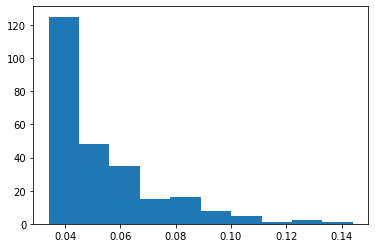

In [19]:
from utils import check_grads
check_grads(model, seeds, plot_wandb=plot_wandb)

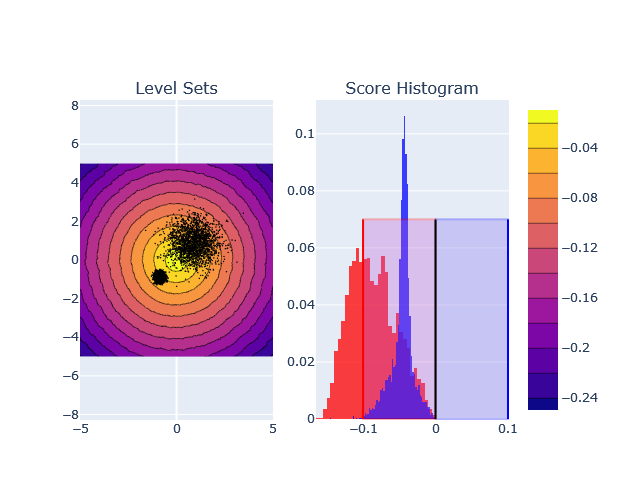

In [20]:
plot_contour(model, loss_fn, gen, X, y, rel_height=0.07)

In [21]:
train_loop(model, opt, loss_fn, gen, dataset, epoch_length)

  0%|          | 0/800 [00:00<?, ?it/s]

100%|██████████| 800/800 [03:05<00:00,  4.31it/s, false_positive=0.00%, grad_norm=0.581, loss=0.0535, recall=0.00%]


In [22]:
train_loop(model, opt, loss_fn, gen, dataset, epoch_length)

100%|██████████| 800/800 [03:00<00:00,  4.42it/s, false_positive=0.00%, grad_norm=0.694, loss=0.0263, recall=0.00%]


In [23]:
train_loop(model, opt, loss_fn, gen, dataset, epoch_length)

100%|██████████| 800/800 [03:00<00:00,  4.43it/s, false_positive=0.00%, grad_norm=0.73, loss=0.0252, recall=0.00%] 


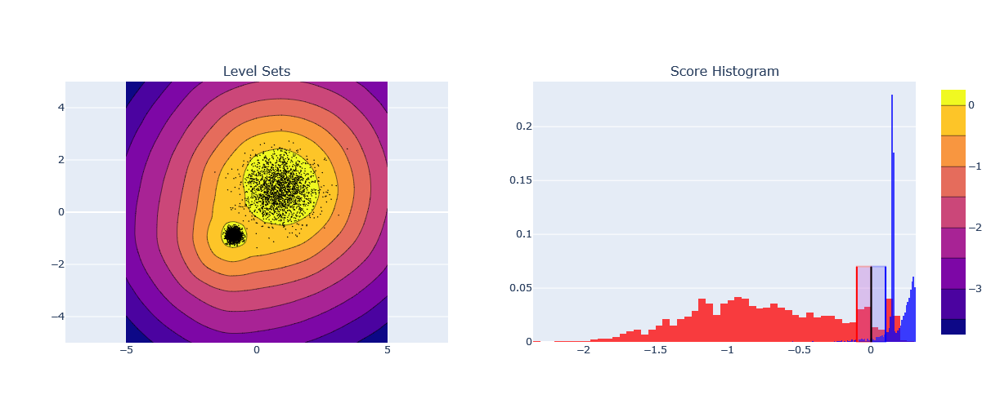

In [24]:
plot_contour(model, loss_fn, gen, X, y, rel_height=0.07)

S=1.6743568181991577 2-inf=[('0.002590229967609048', '0.25011003017425537')] inf=[('0.0033495917450636625', '0.3243899345397949')] 2=[(1.3259162, 1.6743568)]
S=15.651300430297852 2-inf=[('1.2473350763320923', '1.7638236284255981')] inf=[('22.471294403076172', '33.53599548339844')] 2=[(0.684225, 15.6513)]
S=15.437145233154297 2-inf=[('1.2620936632156372', '2.024850606918335')] inf=[('22.209877014160156', '37.789031982421875')] 2=[(0.64835685, 15.437145)]
S=16.126737594604492 2-inf=[('1.2084969282150269', '1.7443513870239258')] inf=[('21.763158798217773', '32.14442443847656')] 2=[(0.5267423, 16.126738)]
S=1.0 2-inf=[('1.0', '1.0')] inf=[('17.80883026123047', '17.80883026123047')] 2=[(1.0, 1.0)]
127 tf.Tensor([0.9278782], shape=(1,), dtype=float32)
GradSeedNorm: tf.Tensor([[0.9278782]], shape=(1, 1), dtype=float32)
LLC = Local Lipschitz Constant
Input, LLC wrt Input, LLC wrt previous layer
Input:  Input 0.009278752979109286 0.009278752979109286
0 <class 'deel.lip.layers.SpectralDense'> 1.

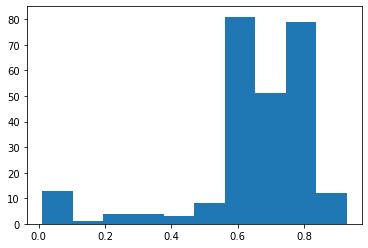

In [25]:
check_grads(model, seeds, plot_wandb=plot_wandb)

In [26]:
train_loop(model, opt, loss_fn, gen, dataset, epoch_length)

100%|██████████| 800/800 [03:01<00:00,  4.40it/s, false_positive=0.00%, grad_norm=0.739, loss=0.0253, recall=0.00%]


In [27]:
train_loop(model, opt, loss_fn, gen, dataset, epoch_length)

100%|██████████| 800/800 [03:02<00:00,  4.38it/s, false_positive=0.00%, grad_norm=0.713, loss=0.0255, recall=0.00%]


In [28]:
train_loop(model, opt, loss_fn, gen, dataset, epoch_length)

100%|██████████| 800/800 [02:59<00:00,  4.45it/s, false_positive=0.00%, grad_norm=0.709, loss=0.0262, recall=0.00%]


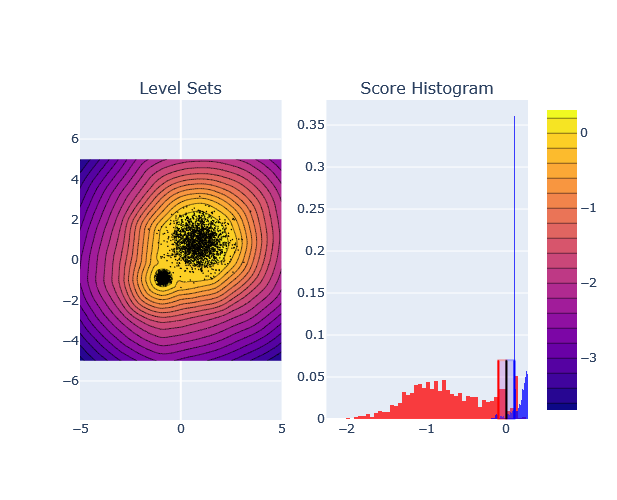

In [29]:
plot_contour(model, loss_fn, gen, X, y, rel_height=0.07)

S=2.122800588607788 2-inf=[('0.003274482674896717', '0.30867600440979004')] inf=[('0.00456363707780838', '0.3886992335319519')] 2=[(1.6331944, 2.1228006)]
S=21.646625518798828 2-inf=[('1.442232370376587', '2.2994749546051025')] inf=[('25.847129821777344', '44.100887298583984')] 2=[(0.6363385, 21.646626)]
S=21.059865951538086 2-inf=[('1.4473189115524292', '3.080047369003296')] inf=[('25.1138916015625', '60.286067962646484')] 2=[(0.597251, 21.059866)]
S=23.397008895874023 2-inf=[('1.4603970050811768', '2.415865659713745')] inf=[('25.733322143554688', '46.541141510009766')] 2=[(0.22226392, 23.397009)]
S=1.0 2-inf=[('1.0', '1.0')] inf=[('19.122350692749023', '19.122350692749023')] 2=[(1.0, 1.0)]
127 tf.Tensor([0.94277036], shape=(1,), dtype=float32)
GradSeedNorm: tf.Tensor([[0.94275635]], shape=(1, 1), dtype=float32)
LLC = Local Lipschitz Constant
Input, LLC wrt Input, LLC wrt previous layer
Input:  Input 0.009427638608408758 0.009427638608408758
0 <class 'deel.lip.layers.SpectralDense'> 1

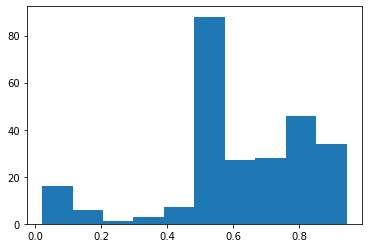

In [30]:
check_grads(model, seeds, plot_wandb=plot_wandb)

In [31]:
train_loop(model, opt, loss_fn, gen, dataset, epoch_length)

100%|██████████| 800/800 [03:01<00:00,  4.42it/s, false_positive=0.00%, grad_norm=0.728, loss=0.0263, recall=0.00%]


In [32]:
train_loop(model, opt, loss_fn, gen, dataset, epoch_length)

100%|██████████| 800/800 [02:59<00:00,  4.45it/s, false_positive=0.00%, grad_norm=0.736, loss=0.0265, recall=0.00%]


In [33]:
train_loop(model, opt, loss_fn, gen, dataset, epoch_length)

100%|██████████| 800/800 [03:00<00:00,  4.42it/s, false_positive=0.00%, grad_norm=0.725, loss=0.0263, recall=0.00%]


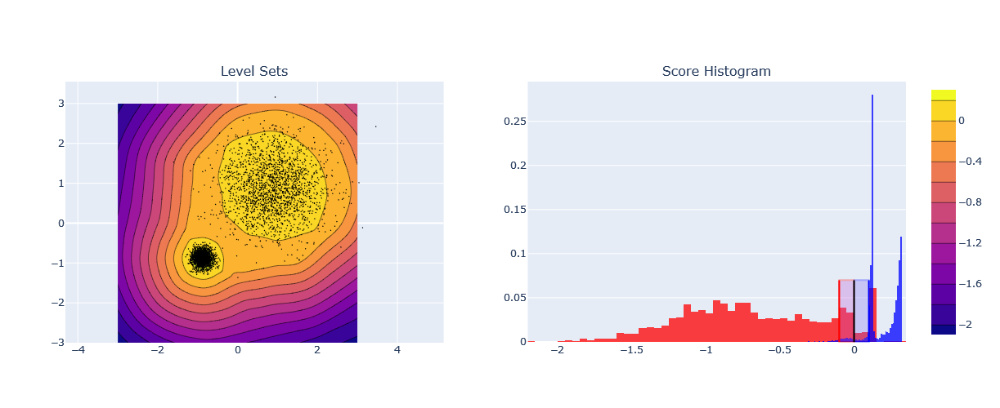

In [34]:
plot_contour(model, loss_fn, gen, X, y, rel_height=0.07, domain=[-3, 3], save_file=False)

S=2.4967894554138184 2-inf=[('0.002571405842900276', '0.36472389101982117')] inf=[('0.0028265491127967834', '0.4555143117904663')] 2=[(1.9067565, 2.4967895)]
S=26.384384155273438 2-inf=[('1.5947823524475098', '2.9345040321350098')] inf=[('29.040271759033203', '56.07498550415039')] 2=[(0.5671676, 26.384384)]
S=25.398818969726562 2-inf=[('1.5994617938995361', '3.832024335861206')] inf=[('27.125171661376953', '76.4908447265625')] 2=[(0.39469355, 25.398819)]
S=28.40152931213379 2-inf=[('1.6483771800994873', '2.8223366737365723')] inf=[('29.523738861083984', '54.40156555175781')] 2=[(0.10193204, 28.40153)]
S=1.0000001192092896 2-inf=[('1.0', '1.0')] inf=[('19.61128044128418', '19.61128044128418')] 2=[(1.0000001, 1.0000001)]
127 tf.Tensor([0.95226747], shape=(1,), dtype=float32)
GradSeedNorm: tf.Tensor([[0.9522675]], shape=(1, 1), dtype=float32)
LLC = Local Lipschitz Constant
Input, LLC wrt Input, LLC wrt previous layer
Input:  Input 0.009522662640073483 0.009522662640073483
0 <class 'deel.l

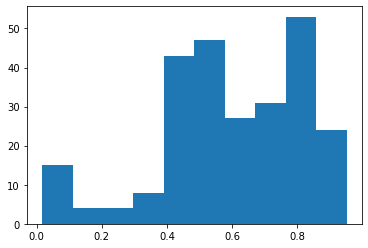

In [35]:
check_grads(model, seeds, plot_wandb=plot_wandb)

In [36]:
train_loop(model, opt, loss_fn, gen, dataset, epoch_length)

100%|██████████| 800/800 [03:02<00:00,  4.37it/s, false_positive=0.00%, grad_norm=0.773, loss=0.0267, recall=0.00%]


In [37]:
train_loop(model, opt, loss_fn, gen, dataset, epoch_length)

100%|██████████| 800/800 [03:00<00:00,  4.44it/s, false_positive=0.00%, grad_norm=0.742, loss=0.0267, recall=0.00%]


In [38]:
train_loop(model, opt, loss_fn, gen, dataset, epoch_length)

100%|██████████| 800/800 [02:57<00:00,  4.52it/s, false_positive=0.00%, grad_norm=0.717, loss=0.0267, recall=0.00%]


S=2.814127206802368 2-inf=[('0.0008814557222649455', '0.3869340717792511')] inf=[('0.001244378974661231', '0.48740124702453613')] 2=[(2.1171334, 2.8141272)]
S=30.26605224609375 2-inf=[('1.7206597328186035', '3.689164638519287')] inf=[('31.12112045288086', '71.4961166381836')] 2=[(0.45731327, 30.266052)]
S=29.238752365112305 2-inf=[('1.6935713291168213', '4.3436665534973145')] inf=[('28.662370681762695', '87.103515625')] 2=[(0.2540507, 29.238752)]
S=31.76630210876465 2-inf=[('1.796356439590454', '3.2448413372039795')] inf=[('32.242218017578125', '62.10829544067383')] 2=[(0.05902937, 31.766302)]
S=0.9999999403953552 2-inf=[('1.0', '1.0')] inf=[('19.77869415283203', '19.77869415283203')] 2=[(0.99999994, 0.99999994)]
127 tf.Tensor([0.9608027], shape=(1,), dtype=float32)
GradSeedNorm: tf.Tensor([[0.9608027]], shape=(1, 1), dtype=float32)
LLC = Local Lipschitz Constant
Input, LLC wrt Input, LLC wrt previous layer
Input:  Input 0.00960812064499233 0.00960812064499233
0 <class 'deel.lip.layers

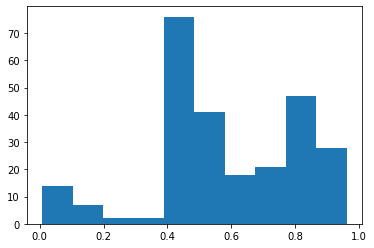

In [39]:
check_grads(model, seeds, plot_wandb=plot_wandb)

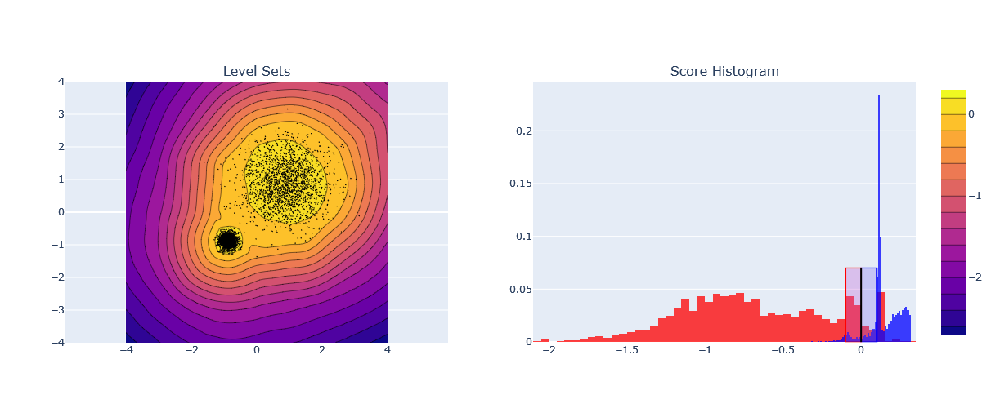

In [48]:
plot_contour(model, loss_fn, gen, X, y, rel_height=0.07, domain=[-4, 4], save_file=False)

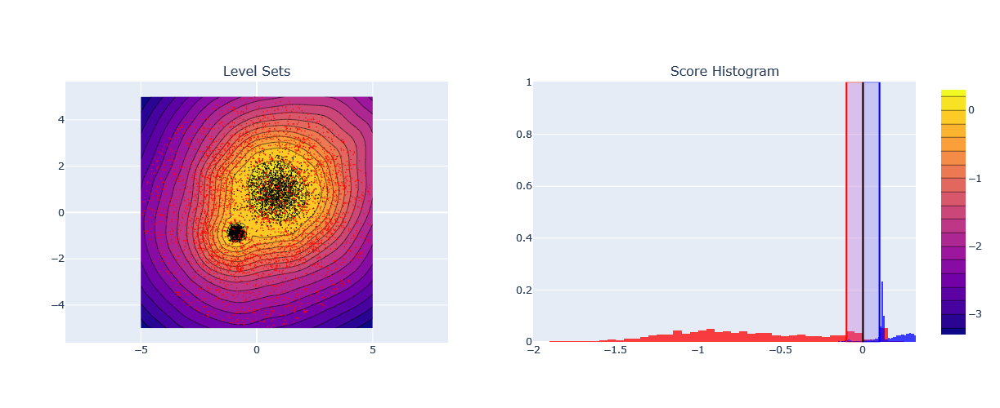

In [41]:
plot_contour(model, loss_fn, gen, X, y, histogram=True, plot_seeds=True, save_file=False)

In [42]:
if plot_wandb:
    wandb.finish()

GradSeedNorm,▁████
false_positive,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
grad_norm,▁▃▅▆▇▇█▇▇█████▇█████▇███████████████▇███
loss,█▄▃▁▂▂▂▂▃▂▁▂▂▃▄▂▁▃▂▃▂▂▂▂▂▃▃▂▂▂▁▂▂▂▂▃▃▃▂▃
recall,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
GradSeedNorm,0.9608
false_positive,0
grad_norm,0.71675
loss,0.03494
recall,0


### Compare with Sklearn

Plot something similar to Lipschitz model but for Sklearn models.

In [43]:
from sklearn.ensemble import IsolationForest
from sklearn.svm import OneClassSVM

def get_sk_contour(model, domain, resolution):
  """Return grid with level sets from model.
  
  Args:
      model: the classifier to plot
      domain: domain on which to plot the classifier level sets
      resolution: number of pixels in discretization
      
  Returns:
      grid with predictions, x and y coordinnaates of the grid. 
  """
  xmin, xmax = domain[0], domain[1]
  ymin, ymax = domain[0], domain[1]
  x_coords = np.linspace(xmin, xmax, resolution)
  y_coords = np.linspace(ymin, ymax, resolution)
  x_grid, y_grid = np.meshgrid(x_coords, y_coords)
  grid = np.stack([x_grid.flatten(), y_grid.flatten()], axis=-1)
  z_grid = model.decision_function(grid)
  z_grid = z_grid.reshape(x_grid.shape)
  return z_grid, x_coords, y_coords, grid

def plot_sk_contour(model, X, y,
                    fig, col,
                    domain=None):  # domain on which to plot the data.
    if domain is None:
        domain = config.domain
    z_grid, x_coords, y_coords, grid = get_sk_contour(model, domain, resolution=300)    
    fig.add_trace(go.Contour(z=z_grid, x=x_coords, y=y_coords, ncontours=20), row=1, col=col)
    fig.add_trace(go.Scatter(x=X[:,0], y=X[:,1], mode='markers', marker=dict(size=1.5, color='black')), row=1, col=col)
    return fig

In [44]:
def get_sk_model(sk_model_name):
    outliers_fraction = 0.05
    if sk_model_name == 'if':
        sk_model = IsolationForest(contamination=outliers_fraction)
    elif sk_model_name == 'ocsvm':
        sk_model = OneClassSVM(nu=outliers_fraction, kernel="rbf", gamma='scale')
    return sk_model

In [45]:
def train_plot_sk_model(fig, col, ds_name, sk_model_name, domain):
    X, y = get_np_dataset_from_str(ds_name, config.num_pts, config.noise)
    X, y = default_process(X, y)
    sk_model = get_sk_model(sk_model_name)
    sk_model.fit(X, y)
    plot_sk_contour(sk_model, X, y, fig, col, domain=domain)

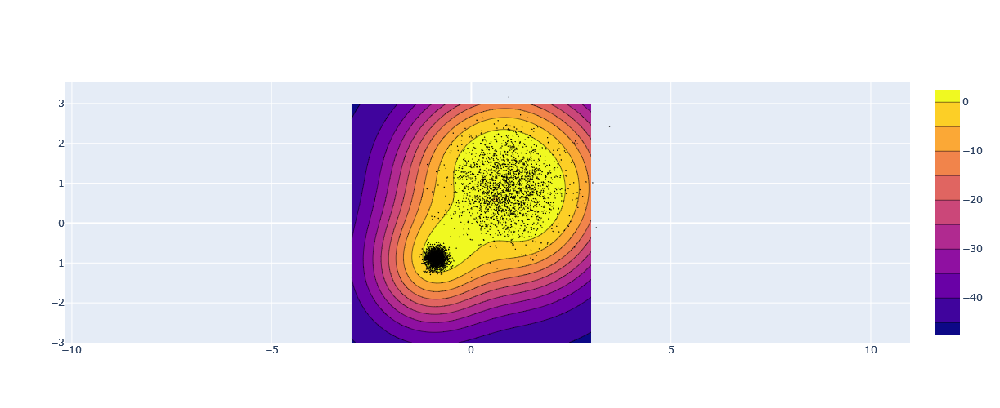

In [46]:
num_cols = 1
fig = make_subplots(rows=1, cols=num_cols, shared_yaxes=True)
sk_model_name = "ocsvm"  # or "if"
train_plot_sk_model(fig, 1, config.dataset_name, sk_model_name, domain=[-3, 3])
width = num_cols * 500
fig.update_layout(autosize=False, width=width, height=500, showlegend=False, barmode='overlay')
fig.update_yaxes(
    scaleanchor = "x",
    scaleratio = 1,
    row=1,
    col=1,
)